### Group_Name: ToonSquad
    - Imroz Rahim - 2011129
    - Iffaat Ara Mehnaz - 2031340
    - Sibgat Ul Islam - 2111920
   
EDA and Pre-Processing

In [1]:
!git clone https://github.com/Sibgat-Ul/Road_Accidents_Pakistan_Prediction/ && mv ./Road_Accidents_Pakistan_Prediction/* ./

Cloning into 'Road_Accidents_Pakistan_Prediction'...
remote: Enumerating objects: 47, done.
remote: Counting objects: 100% (47/47), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 47 (delta 18), reused 32 (delta 8), pack-reused 0 (from 0)
Receiving objects: 100% (47/47), 9.86 MiB | 18.29 MiB/s, done.
Resolving deltas: 100% (18/18), done.


In [15]:
! ls ./data

 dataset_description.txt  'RTA Data 2020 to July 2023.xlsx'   Tong-etal_2024.tab


### Import the libraries

In [2]:
import pandas as pd
import numpy as np
from openpyxl.styles.builtins import total

import seaborn as sns
import matplotlib.pyplot as plt

import warnings

warnings.filterwarnings('ignore')

### Few helper functions:

In [3]:
def get_cat_cols(df: pd.DataFrame) -> list:
    """"
    :param df: Dataframe
    :return: list of column names

    to get categorical columns
    """
    return [col for col in df.columns if df[col].dtype == 'object']

def get_num_cols(df):
    """"
    :param df: Dataframe
    :return: list of column names

    to get num columns
    """
    return [col for col in df.columns if df[col].dtype != 'object']

def get_info(dataset: pd.DataFrame):
    """

    :param dataset: pd.DataFrame
    :return: pd.DataFrame

    Makes a new df with missing and unique values.
    """
    new_df = pd.DataFrame()
    new_df['missing_count'] = dataset.isnull().sum()
    new_df['total'] = dataset.shape[0]
    new_df['missing%'] = (dataset.isnull().sum() / dataset.shape[0])*100
    new_df['n_unique'] = dataset.nunique()
    new_df['type'] = dataset.dtypes
    print(f"Size: {rta_dataset.shape}")
    return new_df

### File imports

In [9]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [17]:
# Importing the dataset

rta_dataset = pd.read_excel('./data/RTA Data 2020 to July 2023.xlsx')
cat_cols = get_cat_cols(rta_dataset)
num_cols = get_num_cols(rta_dataset)

### Some info of our dataset

In [18]:
info_df = get_info(rta_dataset)
info_df

Size: (46189, 25)


,missing_count,total,missing%,n_unique,type
EcYear,0,46189,0.000000,5,object
EcNumber,7211,46189,15.611942,34800,object
CallTime,5956,46189,12.894845,40170,datetime64[ns]
EmergencyArea,1,46189,0.002165,37520,object
TotalPatientsInEmergency,0,46189,0.000000,13,object
Gender,1,46189,0.002165,4,object
Age,1,46189,0.002165,100,float64
HospitalName,21950,46189,47.522137,162,object
Reason,1,46189,0.002165,23940,object
responsetime,5,46189,0.010825,68,float64


In [19]:
rta_dataset

,EcYear,EcNumber,CallTime,EmergencyArea,TotalPatientsInEmergency,Gender,Age,HospitalName,Reason,responsetime,...,BikesInvolved,BusesInvolved,CarsInvolved,CartInvovled,RickshawsInvolved,TractorInvovled,TrainsInvovled,TrucksInvolved,VansInvolved,OthersInvolved
0,2020,31486,2020-12-31 22:41:47,NEAR APS SCHOOL FORT ROAD RWP,1,Male,27.0,BBH,Bike Slip,10.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2020,31485,2020-12-31 22:25:00,"Infront of Daig.com, Near Dha gate 2, gt road...",1,Male,20.0,NaN,Car hit Footpath,12.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2020,31483,2020-12-31 21:54:59,Muhammadi chowk arshad bakery khyaban e sirsye...,1,Male,48.0,BBH,Rickshaw hit with Car,10.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,2020,31482,2020-12-31 21:24:22,"Gulzar e quaid, T/W Katcheri Near Attock Pump,...",1,Male,45.0,NaN,Car hit Car and runaway,5.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2020,31479,2020-12-31 21:03:49,Taaj Company Gawalmandi Chowk Liaqat Baag Road...,1,Male,22.0,NaN,Unknown Bike hit Bike and runaway,5.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46184,2023,NaN,NaT,Infront Of Mian G hotel GT Road Mandra,2,Male,20.0,"RHC,Mandra,Rawalpindi",.,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
46185,2023,356986,2023-01-01 04:23:00,"Barma Shell Depu Dhoke Munshi Road, Fazal Town...",1,Male,16.0,DHQ,Bike slipped due to over speed.(RIN.6276) C D...,11.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46186,2023,356981,2023-01-01 02:16:00,Main Bakra Mandi Chowk Rwp,1,Female,10.0,NaN,RLF-2193 coure and ICT-593 corolla car colliped,1.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46187,2023,356980,2023-01-01 02:02:00,"Darbar Adda, Mandi Morr, Bus Stop, Ijp Road, Rwp",1,Male,19.0,NaN,Bike slipped due to Over speed ( Bike no TSH ...,12.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Checking the unique values

In [20]:
target_column = 'PatientStatus'

filtered_cols = rta_dataset[info_df[info_df['n_unique'] < 15].index]
unique_values = [{f'{col}: {rta_dataset[col].unique()}'} for col in filtered_cols.columns]
unique_values

[{"EcYear: [2020 2021 2022 'Hospital' 2023]"},
 {"TotalPatientsInEmergency: [1 2 3 4 8 6 5 10 7 11 9 'Alive & unstable' 15]"},
 {"Gender: ['Male' 'Female' 'Other' nan 0]"},
 {"EducationTitle: ['Intermediate' 'Illetrate' 'Matric' 'Primary' 'Graduation' 'Masters'\n 'Middle' 'PHD' nan 0]"},
 {"InjuryType: ['Minor' 'Single Fracture' 'Head Injury' 'Multiple Fractures'\n 'Spinal Injury' nan]"},
 {"Cause: ['Over Speed' 'Carelessness' 'Tyre Burst' 'U Turn' 'Others' 'Wrong Turn'\n 'One Wheeling' nan]"},
 {"PatientStatus: ['Alive & unstable' 'Alive & stable' 'Dead' nan]"},
 {'BicycleInvovled: [ 0.  1.  2. nan]'},
 {'BikesInvolved: [ 1.  0.  2.  3. 10. nan]'},
 {'BusesInvolved: [ 0.  1.  2. nan]'},
 {'CarsInvolved: [ 0.  1.  2.  3.  4. nan  5.]'},
 {'CartInvovled: [ 0.  1. nan]'},
 {'RickshawsInvolved: [ 0.  1.  2. nan]'},
 {'TractorInvovled: [ 0.  1. nan]'},
 {'TrainsInvovled: [ 0.  1. nan]'},
 {'TrucksInvolved: [ 0.  1.  2.  3. nan]'},
 {'VansInvolved: [ 0.  1.  2.  4.  3. nan]'},
 {'OthersInvo

### Processing
- We will drop the columns with the most missing values
- drop the rows having problematic values (EcYear with Hospital, 0 for Gender)

We have considered dropping rather than filling the values because there are enough samples available.

In [21]:
def drop_garbage_rows(df, col, to_drop):
    df.drop(index=df[df[col] == to_drop].index, axis=0, inplace=True)


drop_garbage_rows(rta_dataset, "EcYear", "Hospital")
drop_garbage_rows(rta_dataset, "Gender", 0)
drop_garbage_rows(rta_dataset, "TotalPatientsInEmergency", 'Alive & unstable')
drop_garbage_rows(rta_dataset, "EducationTitle", 0)

In [22]:
rta_dataset.drop(columns=['HospitalName', 'EcNumber', 'CallTime'], inplace=True)

In [23]:
# Another problematic row
rta_dataset[rta_dataset["Gender"].isnull()]

,EcYear,EmergencyArea,TotalPatientsInEmergency,Gender,Age,Reason,responsetime,EducationTitle,InjuryType,Cause,...,BikesInvolved,BusesInvolved,CarsInvolved,CartInvovled,RickshawsInvolved,TractorInvovled,TrainsInvovled,TrucksInvolved,VansInvolved,OthersInvolved
31355,2022,"Near 502 Park, Adyala Road Rawalpindi.",2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Few more problematic rows

In [24]:
rta_dataset.drop(index=rta_dataset[rta_dataset["Gender"].isnull()].index, inplace=True)
rta_dataset.drop(index=rta_dataset[rta_dataset["EmergencyArea"].isnull()].index, inplace=True)
rta_dataset.drop(index=rta_dataset[rta_dataset["responsetime"].isnull()].index, inplace=True)

### No missing values after processing

and we even have enough samples to train the model.

In [25]:
get_info(rta_dataset)

Size: (46182, 22)


,missing_count,total,missing%,n_unique,type
EcYear,0,46182,0.0,4,object
EmergencyArea,0,46182,0.0,37515,object
TotalPatientsInEmergency,0,46182,0.0,12,object
Gender,0,46182,0.0,3,object
Age,0,46182,0.0,100,float64
Reason,0,46182,0.0,23934,object
responsetime,0,46182,0.0,68,float64
EducationTitle,0,46182,0.0,8,object
InjuryType,0,46182,0.0,5,object
Cause,0,46182,0.0,7,object


In [26]:
cat_cols = get_cat_cols(rta_dataset)
num_cols = get_num_cols(rta_dataset)

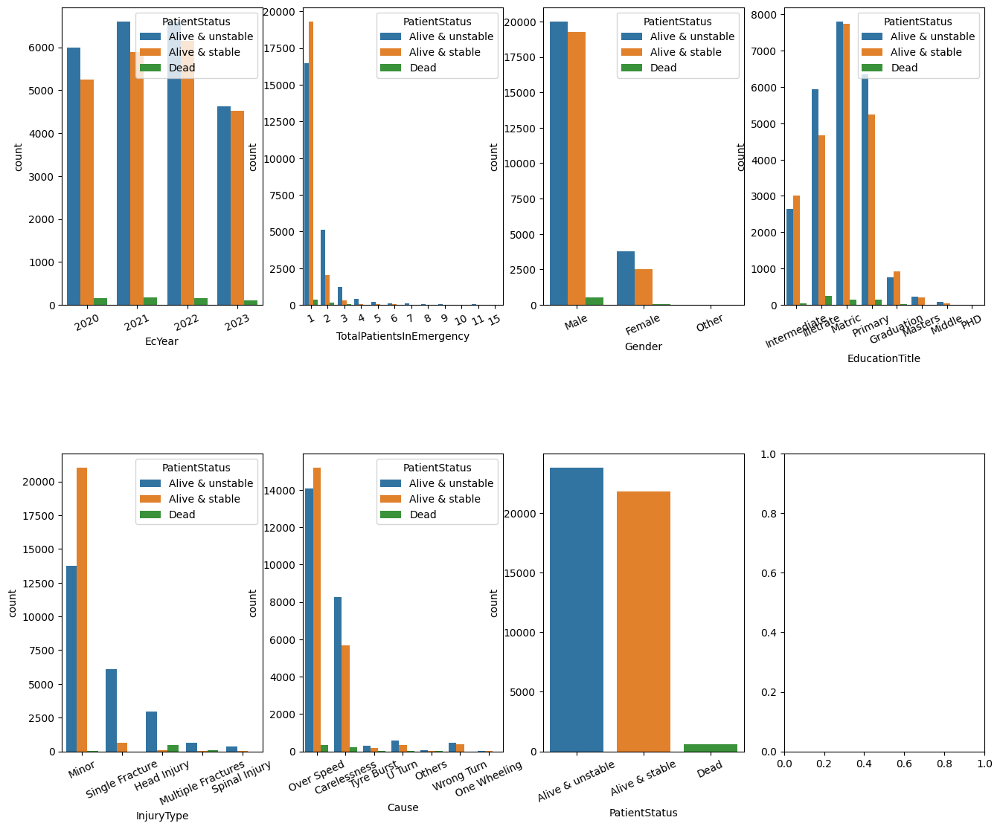

In [27]:
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(16, 13))
plt.subplots_adjust(hspace=.5)

r, c = 0, 0

for col in filtered_cols:
    if col in cat_cols:
        plot = sns.countplot(data=rta_dataset, x=rta_dataset[col], hue='PatientStatus', ax=axes[r, c])
        plot.set_xticklabels(plot.get_xticklabels(), rotation=25)

    if c < 3:
        c = c + 1
    else:
        c = 0
        if r < 1:
            r = r + 1

plt.show()

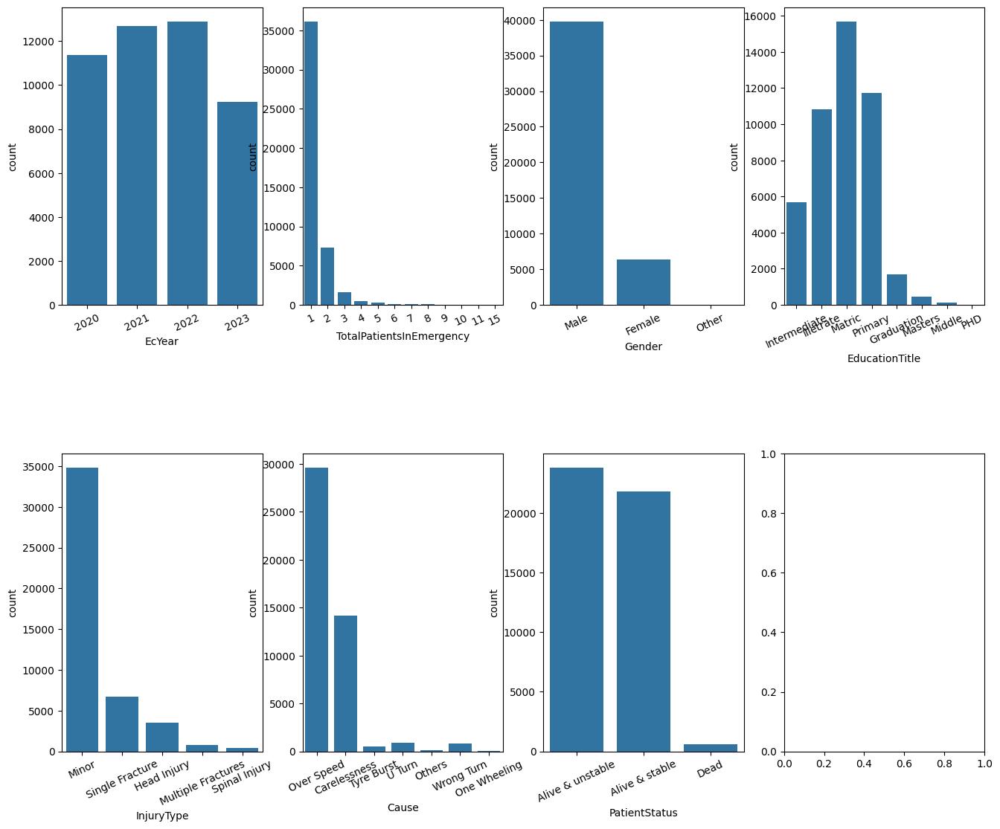

In [22]:
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(16, 13))
plt.subplots_adjust(hspace=.5)

r, c = 0, 0

for col in filtered_cols.columns:
    if col in cat_cols:
        plot = sns.countplot(data=rta_dataset, x=rta_dataset[col], ax=axes[r, c])
        plot.set_xticklabels(plot.get_xticklabels(), rotation=25)
    if c < 3:
        c = c + 1
    else:
        c = 0
        if r < 1:
            r = r + 1

plt.show()

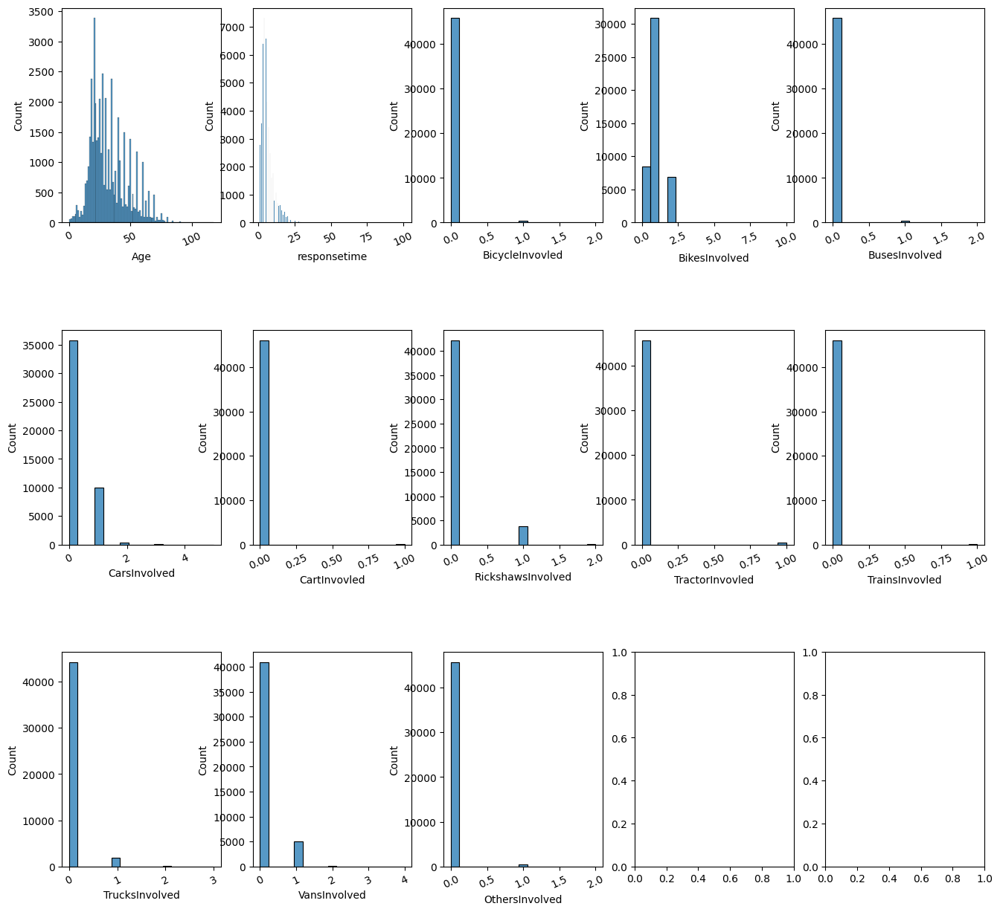

In [23]:
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(16, 15))
plt.subplots_adjust(hspace=.5)

r, c = 0, 0

for col in num_cols:
    plot = sns.histplot(data=rta_dataset, x=col, ax=axes[r, c])
    plot.set_xticklabels(plot.get_xticklabels(), rotation=25)
    if c < 4:
        c = c + 1
    else:
        c = 0
        if r < 2:
            r = r + 1


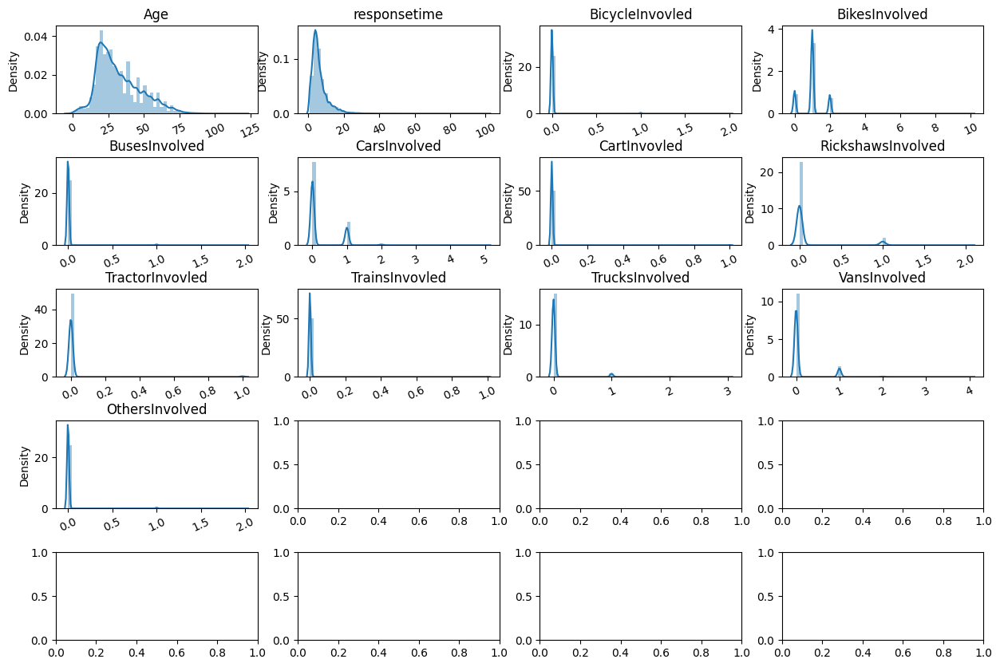

In [24]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(15, 10))
plt.subplots_adjust(hspace=.5)

r, c = 0, 0

for col in num_cols:
    plot = sns.distplot(x=rta_dataset[col], ax=axes[r, c])
    plot.set_xticklabels(plot.get_xticklabels(), rotation=25)
    plot.set_title(col)
    if c < 3:
        c = c + 1
    else:
        c = 0
        if r < 4:
            r = r + 1


<Axes: xlabel='PatientStatus', ylabel='count'>

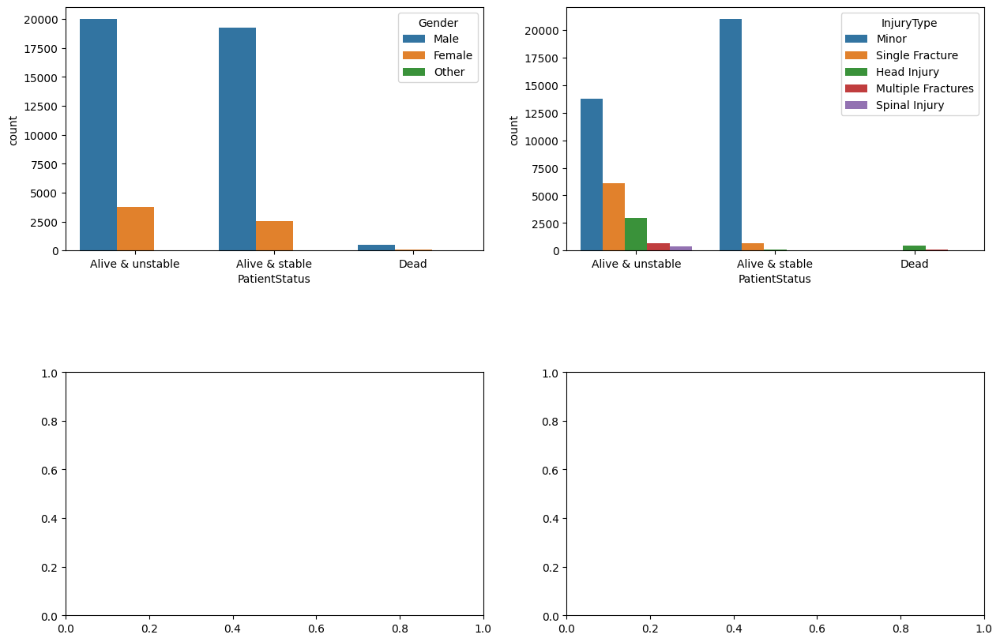

In [25]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 10))
plt.subplots_adjust(hspace=.5)

sns.countplot(data=rta_dataset, x='PatientStatus', hue='Gender', ax=axes[0,0])

sns.countplot(data=rta_dataset, x='PatientStatus', hue='InjuryType', ax=axes[0,1])

# plot3 = sns.countplot(data=rta_dataset, x='CallTime', hue='PatientStatus', ax=axes[1,0])
# plot3.set_xticklabels(plot3.get_xticklabels(), rotation=80)

# sns.countplot(data=rta_dataset, x='PatientStatus', hue='Gender', ax=axes[1,1])

<Axes: >

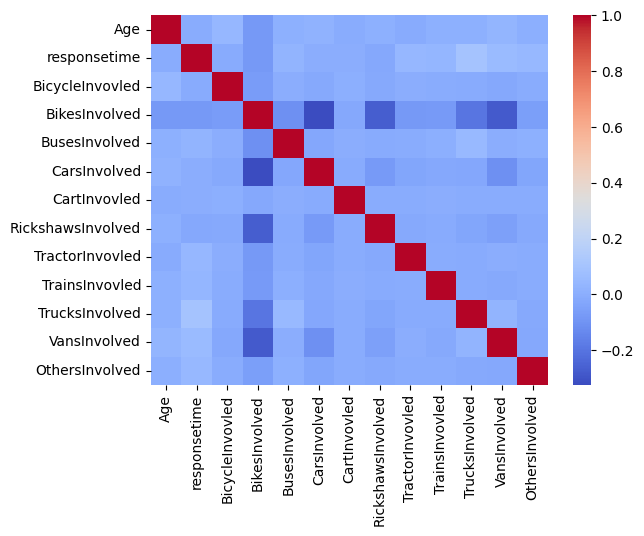

In [26]:
sns.heatmap(rta_dataset[num_cols].corr(), cmap='coolwarm')

Vectorizing Reason Column

In [27]:
rta_dataset['Reason']

,Reason
0,Bike Slip
1,Car hit Footpath
2,Rickshaw hit with Car
3,Car hit Car and runaway
4,Unknown Bike hit Bike and runaway
...,...
46184,.
46185,Bike slipped due to over speed.(RIN.6276) C D...
46186,RLF-2193 coure and ICT-593 corolla car colliped
46187,Bike slipped due to Over speed ( Bike no TSH ...


In [28]:
!pip install pandas scikit-learn openpyxl
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()
vectorized = vectorizer.fit_transform(rta_dataset['Reason']).toarray() # Convert the sparse matrix to a dense array
vectorized[0:10]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [31]:
len(vectorized)

46182

In [29]:
import pandas as pd

# Load your dataset
rta_dataset = pd.read_excel('/content/drive/MyDrive/CSE445/RTA Data 2020 to July 2023.xlsx')

# Extract the 'Reason' column and handle missing values
reasons = rta_dataset['Reason'].fillna('')


In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Initialize the TF-IDF Vectorizer
tfidf = TfidfVectorizer(max_features=None, ngram_range=(1, 3), stop_words='english')

reasons = reasons.astype(str)
# Fit and transform the 'Reason' column
tfidf_matrix = tfidf.fit_transform(reasons)

# Get the feature names and convert the matrix to an array
feature_names = tfidf.get_feature_names_out()
tfidf_array = tfidf_matrix.toarray()


In [31]:
# View the first 10 rows of the TF-IDF matrix
print(tfidf_array[:10])

# View the first 10 feature names
print(feature_names[:10])


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
['0010' '0010 cd' '0010 cd china' '002' '002 ict' '002 ict slip' '0033'
 '0033 hitted' '0033 hitted pedestrian' '005']


In [37]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer


# Load your data into the DataFrame
# Use the correct path to your file
df = pd.read_excel('/content/drive/MyDrive/CSE445/RTA Data 2020 to July 2023.xlsx')

# Step 1: Preprocess the Age_band_of_driver column (Label Encoding)
label_encoder = LabelEncoder()
# Ensure the column 'Age' exists in your dataframe. If not, replace 'Age' with the correct column name
df['Age_encoded'] = label_encoder.fit_transform(df['Age'])

# Step 2: Vectorize the Cause_of_accident column using TF-IDF
tfidf_vectorizer = TfidfVectorizer()
# Ensure the column 'Cause' exists in your dataframe. If not, replace 'Cause' with the correct column name
X_tfidf = tfidf_vectorizer.fit_transform(df['Cause'].fillna(''))

# Step 3: Prepare the final dataset
# Use the encoded 'Age_band_of_driver' and the vectorized 'Cause_of_accident'
# Assuming you want to predict 'Accident_severity' as the target variable
X = X_tfidf
# Ensure the column 'InjuryType' exists in your dataframe. If not, replace 'InjuryType' with the correct column name
y = label_encoder.fit_transform(df['InjuryType'].fillna(''))

# Step 4: Split the dataset into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Output the shapes of the resulting datasets
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((36951, 10), (9238, 10), (36951,), (9238,))

In [42]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder

# Load the dataset
df = pd.read_excel('/content/drive/MyDrive/CSE445/RTA Data 2020 to July 2023.xlsx')

# Step 1: Handle missing values by filling with a placeholder or dropping (depending on data)
# Convert 'Age' column to string type to ensure uniformity
df['Age'] = df['Age'].astype(str).fillna('Unknown') # Changed this line
df['Cause'].fillna('Unknown', inplace=True)

# Step 2: Encode the 'Age_band_of_driver' column (label encoding)
age_band_encoder = LabelEncoder()
df['Age'] = age_band_encoder.fit_transform(df['Age'])

# Step 3: Vectorize the 'Cause_of_accident' column using TF-IDF
vectorizer = TfidfVectorizer()
cause_of_accident_tfidf = vectorizer.fit_transform(df['Cause'])

# Convert the TF-IDF matrix to a DataFrame for better readability
tfidf_df = pd.DataFrame(cause_of_accident_tfidf.toarray(), columns=vectorizer.get_feature_names_out())

# Step 4: Combine the vectorized 'Cause_of_accident' with the main dataframe
df_combined = pd.concat([df, tfidf_df], axis=1)

# Display the processed dataframe with vectorized 'Cause_of_accident'
df_combined.head()

,EcYear,EcNumber,CallTime,EmergencyArea,TotalPatientsInEmergency,Gender,Age,HospitalName,Reason,responsetime,...,carelessness,one,others,over,speed,turn,tyre,unknown,wheeling,wrong
0,2020,31486,2020-12-31 22:41:47,NEAR APS SCHOOL FORT ROAD RWP,1,Male,24,BBH,Bike Slip,10.0,...,0.0,0.0,0.0,0.707107,0.707107,0.0,0.0,0.0,0.0,0.0
1,2020,31485,2020-12-31 22:25:00,"Infront of Daig.com, Near Dha gate 2, gt road...",1,Male,17,NaN,Car hit Footpath,12.0,...,0.0,0.0,0.0,0.707107,0.707107,0.0,0.0,0.0,0.0,0.0
2,2020,31483,2020-12-31 21:54:59,Muhammadi chowk arshad bakery khyaban e sirsye...,1,Male,47,BBH,Rickshaw hit with Car,10.0,...,0.0,0.0,0.0,0.707107,0.707107,0.0,0.0,0.0,0.0,0.0
3,2020,31482,2020-12-31 21:24:22,"Gulzar e quaid, T/W Katcheri Near Attock Pump,...",1,Male,44,NaN,Car hit Car and runaway,5.0,...,0.0,0.0,0.0,0.707107,0.707107,0.0,0.0,0.0,0.0,0.0
4,2020,31479,2020-12-31 21:03:49,Taaj Company Gawalmandi Chowk Liaqat Baag Road...,1,Male,19,NaN,Unknown Bike hit Bike and runaway,5.0,...,0.0,0.0,0.0,0.707107,0.707107,0.0,0.0,0.0,0.0,0.0


In [41]:
df.Reason.value_counts() # Return a Series containing counts of unique values in descending order

,count
Reason,
same,2328
Same,1323
Bike Slipped,1223
Same,1015
Bike Slip,957
...,...
Car(FD-178 Honda Swift) Hitted the pedestrian due to over speed,1
Female motor bike pa jta hoa bike slipped hony ki wajhy sy garr gei(Rin 9043),1
Car hit another car (MRAG 734) (u4156),1


In [45]:
import pandas as pd

# Assuming you have a DataFrame 'df' and the column you're interested in is 'column_name'

# Step 1: Identify the unique rows in the column
unique_rows = df['Reason'].unique()

# Step 2: Count the number of unique rows
num_unique_rows = len(unique_rows)

# Step 3: Get the count of each unique row (optional)
unique_counts = df['Reason'].value_counts()

# Output the results
print(f"Number of unique rows: {num_unique_rows}")
print("Counts of each unique row:")
print(unique_counts)


Number of unique rows: 23941
Counts of each unique row:
Reason
same                                                                             2328
Same                                                                             1323
Bike Slipped                                                                     1223
Same                                                                             1015
Bike Slip                                                                         957
                                                                                 ... 
 Car(FD-178 Honda Swift) Hitted the pedestrian due to over speed                    1
Female motor bike pa jta hoa bike slipped hony ki wajhy sy garr gei(Rin 9043)       1
Car hit another car (MRAG 734) (u4156)                                              1
 Unknown van hit the bike (APF-22 US 70cc) and runaway                              1
 Both car hited eachother overspeed                                          

In [53]:
import pandas as pd

# Assuming you have a DataFrame 'df' and the column you're interested in is 'column_name'

# Step 1: Get the value counts of each unique value
value_counts = df['Reason'].value_counts()

# Step 2: Get the most frequent value
most_frequent_value = value_counts.idxmax()

# Step 3: Get the count of the most frequent value
most_frequent_count = value_counts.max()

# Output the result
print(f"The most frequent value is: {most_frequent_value}")
print(f"It appears {most_frequent_count} times.")


The most frequent value is: same
It appears 2328 times.


In [49]:
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder

# Assuming you have a DataFrame 'df' and the two columns are 'feature_column' and 'target_column'

# Step 1: Define X (feature) and y (target)
X = df[['Reason']]  # Feature (Independent variable) - Ensure it's in 2D (hence double brackets)
y = df['Cause']     # Target (Dependent variable)

# Step 2: Convert 'Reason' column to string type
X['Reason'] = X['Reason'].astype(str)

# Step 3: Encode the 'Reason' column using LabelEncoder
label_encoder = LabelEncoder() # Initialize LabelEncoder
X['Reason'] = label_encoder.fit_transform(X['Reason']) # Fit and transform the 'Reason' column

# Step 4: Encode the 'Cause' column using LabelEncoder
label_encoder = LabelEncoder() # Initialize LabelEncoder for 'Cause'
y = label_encoder.fit_transform(y) # Fit and transform the 'Cause' column

# Step 5: Choose a model (e.g., Linear Regression)
model = LinearRegression()

# Step 6: Perform cross-validation (5-fold by default)
cv_scores = cross_val_score(model, X, y, cv=5)

# Step 7: Output the cross-validation scores and mean score
print("Cross-validation scores:", cv_scores)
print("Mean cross-validation score:", cv_scores.mean())

Cross-validation scores: [-0.00673462 -0.00973172  0.00071685 -0.0055105  -0.03081221]
Mean cross-validation score: -0.010414440568279625


In [56]:
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder

# Assuming you have a DataFrame 'df' and the two columns are 'feature_column' and 'target_column'

# Step 1: Define X (feature) and y (target)
X = df[['Reason']]  # Feature (Independent variable) - Ensure it's in 2D (hence double brackets)
y = df['Age']     # Target (Dependent variable)

# Step 2: Convert 'Reason' column to string type
X['Reason'] = X['Reason'].astype(str)

# Step 3: Encode the 'Reason' column using LabelEncoder
label_encoder = LabelEncoder() # Initialize LabelEncoder
X['Reason'] = label_encoder.fit_transform(X['Reason']) # Fit and transform the 'Reason' column

# Step 4: Encode the 'Cause' column using LabelEncoder
label_encoder = LabelEncoder() # Initialize LabelEncoder for 'Cause'
y = label_encoder.fit_transform(y) # Fit and transform the 'Cause' column

# Step 5: Choose a model (e.g., Linear Regression)
model = LinearRegression()

# Step 6: Perform cross-validation (5-fold by default)
cv_scores = cross_val_score(model, X, y, cv=5)

# Step 7: Output the cross-validation scores and mean score
print("Cross-validation scores:", cv_scores)
print("Mean cross-validation score:", cv_scores.mean())

Cross-validation scores: [-0.00024725 -0.00034553 -0.00031047 -0.00031031 -0.00019116]
Mean cross-validation score: -0.0002809449587299451


In [79]:
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder

# Assuming you have a DataFrame 'df' and the two columns are 'feature_column' and 'target_column'

# Step 1: Define X (feature) and y (target)
X = df[['Reason']]  # Feature (Independent variable) - Ensure it's in 2D (hence double brackets)
y = df['InjuryType']     # Target (Dependent variable)

# Step 2: Convert 'Reason' column to string type
X['Reason'] = X['Reason'].astype(str)

# Step 3: Encode the 'Reason' column using LabelEncoder
label_encoder = LabelEncoder() # Initialize LabelEncoder
X['Reason'] = label_encoder.fit_transform(X['Reason']) # Fit and transform the 'Reason' column

# Step 4: Encode the 'Cause' column using LabelEncoder
label_encoder = LabelEncoder() # Initialize LabelEncoder for 'Cause'
y = label_encoder.fit_transform(y) # Fit and transform the 'Cause' column

# Step 5: Choose a model (e.g., Linear Regression)
model = LinearRegression()

# Step 6: Perform cross-validation (5-fold by default)
cv_scores = cross_val_score(model, X, y, cv=5)

# Step 7: Output the cross-validation scores and mean score
print("Cross-validation scores:", cv_scores)
print("Mean cross-validation score:", cv_scores.mean())

Cross-validation scores: [-8.66444489e-04 -1.57360478e-03  6.85115083e-06 -4.31778641e-04
 -2.81164755e-04]
Mean cross-validation score: -0.0006292283030514323


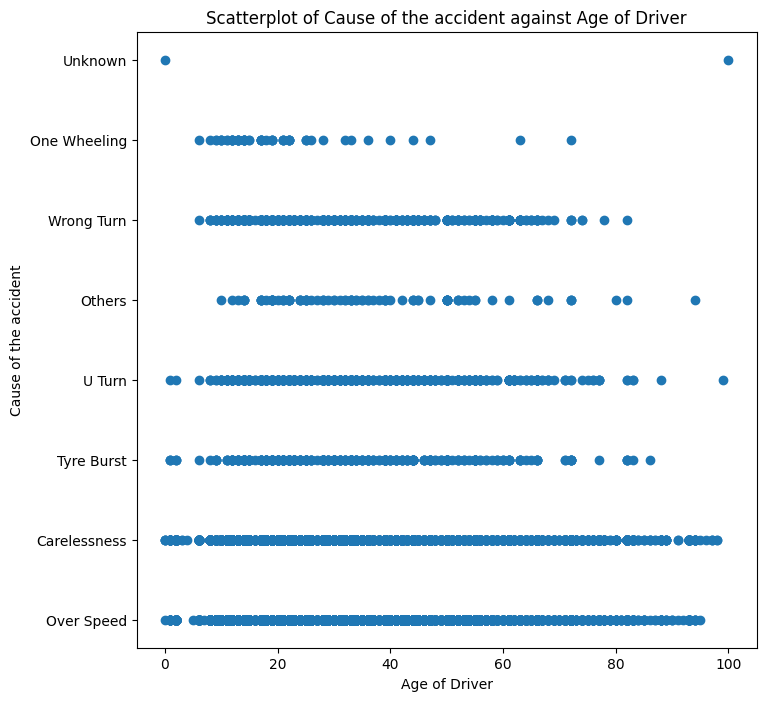

In [43]:
#Let's see how the  Cause of the accident varies with Age of Driver
plt.figure(figsize = (8,8))
plt.scatter(x = 'Age', y = 'Cause', data = df)
# scatter plot with pyplot
plt.xlabel('Age of Driver')
plt.ylabel('Cause of the accident')
plt.title('Scatterplot of Cause of the accident against Age of Driver');

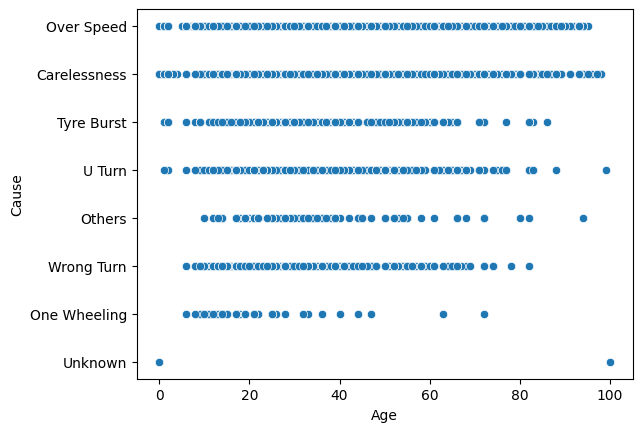

In [50]:
#plt.figure(figsize = (8,8))
sns.scatterplot(x = 'Age', y = 'Cause', data = df);
# scatter plot with Seaborn

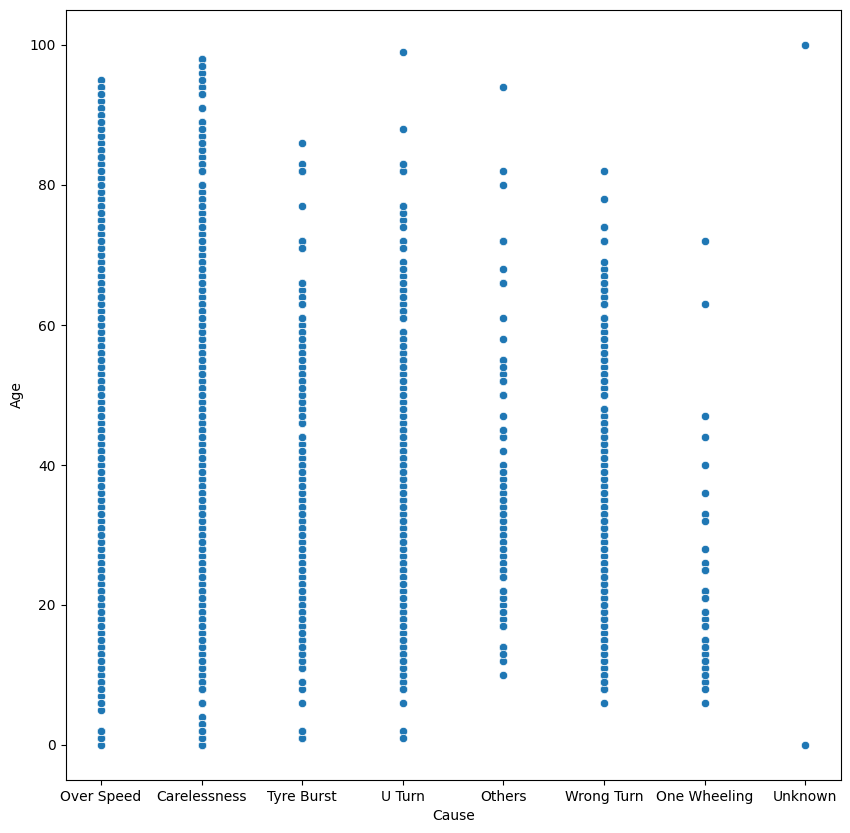

In [63]:
plt.figure(figsize = (10,10))
sns.scatterplot(x = 'Cause', y = 'Age', data = df);
# scatter plot with Seaborn

In [80]:
plt.figure(figsize = (20,200))
sns.scatterplot(x = 'Age', y = 'Reason', data = df.astype({'Reason': str}));
# scatter plot with Seaborn - convert 'Reason' column back to string type

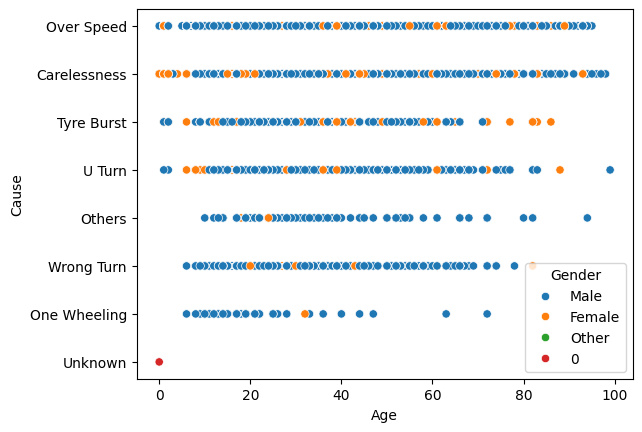

In [65]:
#plt.figure(figsize = (8,8))
sns.scatterplot(x = 'Age', y = 'Cause', hue = 'Gender', data = df);
#plt.axhline(y=222, color='r', linestyle='-');

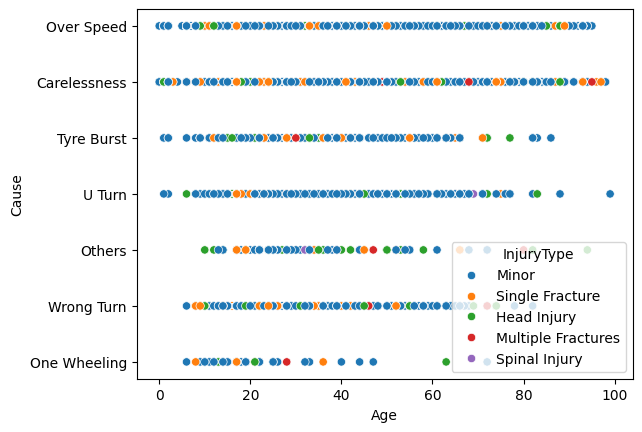

In [72]:
#plt.figure(figsize = (8,8))
sns.scatterplot(x = 'Age', y = 'Cause', hue = 'InjuryType', data = df);
#plt.axhline(y=222, color='r', linestyle='-');

In [73]:
df['Cause'].describe()

,Cause
count,46189
unique,8
top,Over Speed
freq,29586


In [74]:
df['Age'].describe()

,Age
count,46189.000000
mean,31.512092
std,17.012170
min,0.000000
25%,19.000000
50%,28.000000
75%,42.000000
max,100.000000


In [75]:
df['InjuryType'].describe()

,InjuryType
count,46187
unique,5
top,Minor
freq,34788


In [76]:
df['Reason'].describe()

,Reason
count,46188
unique,23940
top,same
freq,2328


Test Accuracy  0.5
Train Accuracy  1.0


<Figure size 25600x25600 with 0 Axes>

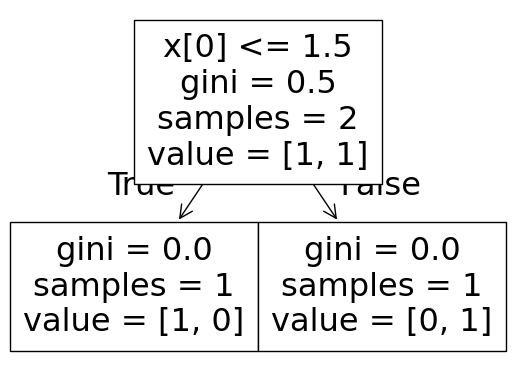

<Figure size 25600x25600 with 0 Axes>

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier

# Load or create your DataFrame here.
# Replace this with your actual data loading or creation code
!pip install pandas
import pandas as pd
df = pd.DataFrame({'target_variable': [0, 1, 0, 1], 'feature1': [1, 2, 3, 4]})

# Assuming 'df' is your DataFrame and 'target_variable' is the name of your target variable column
X = df.drop('target_variable', axis=1)  # Features
y = df['target_variable']  # Target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 0)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 0, stratify = y)
clf = DecisionTreeClassifier() # creates an instance of decision tree classifier
clf.fit(X_train, y_train) # training with training set ALWAYS
y_pred = clf.predict(X_test) # predict with test set. Do not provide y_test
print("Test Accuracy ", accuracy_score(y_pred, y_test)) # accuracy. compare y_test (actual value) with y_pred (predicted value)

y_predTrain = clf.predict(X_train)
print("Train Accuracy ", accuracy_score(y_predTrain, y_train))

from sklearn import tree
tree.plot_tree(clf)
from matplotlib.pyplot import figure

figure(figsize=(128, 128), dpi=200)

In [1]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 0)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 0, stratify = y)
clf = DecisionTreeClassifier() # creates an instance of decision tree classifier
clf.fit(X_train, y_train) # training with training set ALWAYS
y_pred = clf.predict(X_test) # predict with test set. Do not provide y_test
print("Test Accuracy ", accuracy_score(y_pred, y_test)) # accuracy. compare y_test (actual value) with y_pred (predicted value)

y_predTrain = clf.predict(X_train)
print("Train Accuracy ", accuracy_score(y_predTrain, y_train))

from sklearn import tree
tree.plot_tree(clf)
from matplotlib.pyplot import figure

figure(figsize=(128, 128), dpi=200)


NameError: name 'X' is not defined

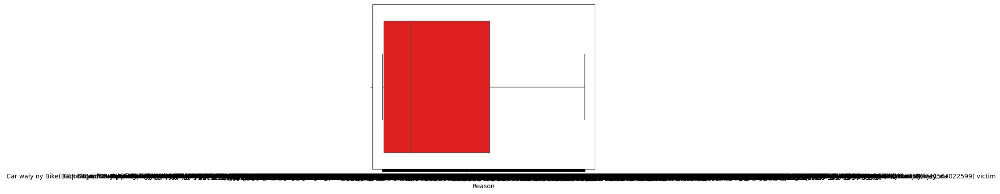

In [82]:
import random
import seaborn as sns

# Convert 'Reason' column to string type
df['Reason'] = df['Reason'].astype(str)

colorlist = ['red', 'yellow', 'orange', 'purple', 'blue']
sns.boxplot(x = 'Reason', data = df, color = random.choice(colorlist)); # horizontal box plot

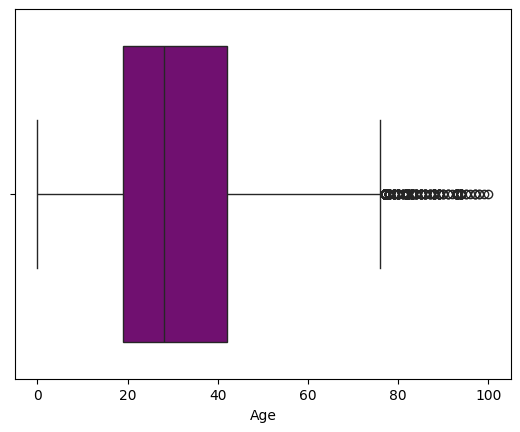

In [83]:
import random
colorlist = ['red', 'yellow', 'orange', 'purple', 'blue']
sns.boxplot(x = 'Age', data = df, color = random.choice(colorlist)); # horizontal box plot

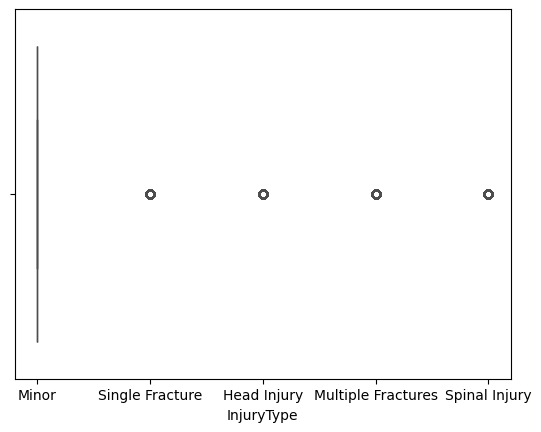

In [84]:
import random
colorlist = ['red', 'yellow', 'orange', 'purple', 'blue']
sns.boxplot(x = 'InjuryType', data = df, color = random.choice(colorlist)); # horizontal box plot

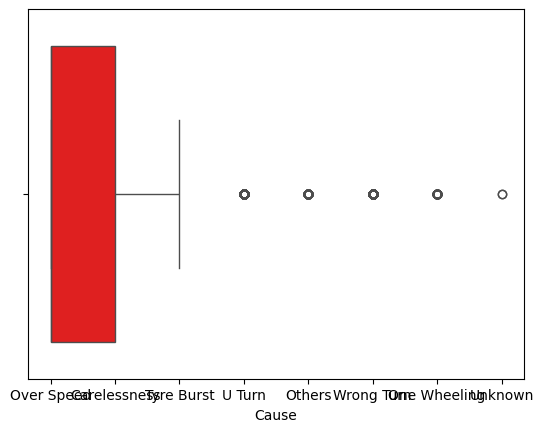

In [86]:
import random
colorlist = ['red', 'yellow', 'orange', 'purple', 'blue']
sns.boxplot(x = 'Cause', data = df, color = random.choice(colorlist)); # horizontal box plot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


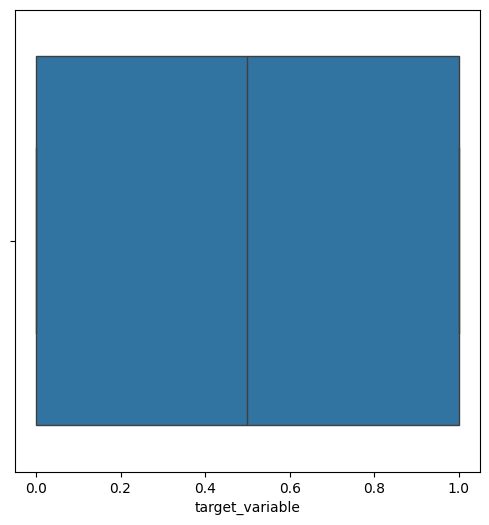

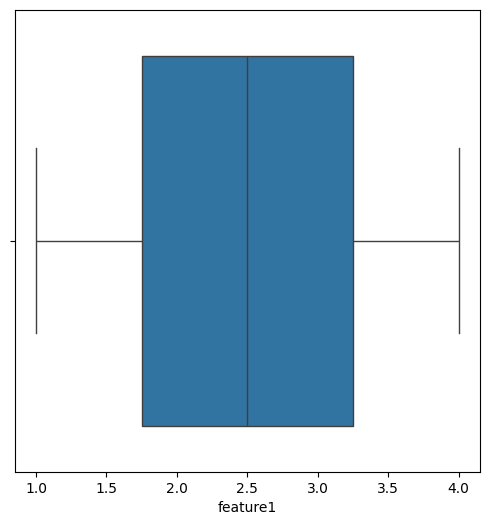

In [8]:
import random
import seaborn as sns
import matplotlib.pyplot as plt

for i in df.columns:
    plt.figure(figsize=(6,6))
    # Removed y argument, as it is not needed when plotting a single variable
    sns.boxplot(x=i, data = df)

In [10]:
import random
import seaborn as sns
import matplotlib.pyplot as plt
for i in df.columns:
    plt.figure(figsize=(6,6))
    sns.boxplot(y=i, x = 'Cause', data = df)

ValueError: Could not interpret value `Cause` for `x`. An entry with this name does not appear in `data`.

<Figure size 600x600 with 0 Axes>

### Getting Unique Values

In [32]:
filtered_cols = rta_dataset[info_df[info_df['n_unique'] < 10].index]
to_encode = [{col: rta_dataset[col].unique()} for col in filtered_cols.columns if col in cat_cols]
to_encode

[{'EcYear': array([2020, 2021, 2022, 'Hospital', 2023], dtype=object)},
 {'Gender': array(['Male', 'Female', 'Other', nan, 0], dtype=object)},
 {'EducationTitle': array(['Intermediate', 'Illetrate', 'Matric', 'Primary', 'Graduation',
         'Masters', 'Middle', 'PHD', nan, 0], dtype=object)},
 {'InjuryType': array(['Minor', 'Single Fracture', 'Head Injury', 'Multiple Fractures',
         'Spinal Injury', nan], dtype=object)},
 {'Cause': array(['Over Speed', 'Carelessness', 'Tyre Burst', 'U Turn', 'Others',
         'Wrong Turn', 'One Wheeling', nan], dtype=object)},
 {'PatientStatus': array(['Alive & unstable', 'Alive & stable', 'Dead', nan], dtype=object)}]

### Looking for the most accident-prone areas

In [33]:
!pip install nltk
import nltk
nltk.download('stopwords')
from collections import Counter
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer


# rta_dataset['Reason'] = rta_dataset['Reason'].replace(to_replace=r".*\(.*\).*", value=" ", regex=True)
#
# rta_dataset['reason_tokenized'] = rta_dataset.apply(lambda row: ','.join([words.lower() for words in row['EmergencyArea'].split(',') if words not in stopwords.words('english') and words != " "]), axis=1)

danger_zone = [
    {status: Counter(rta_dataset[rta_dataset['PatientStatus'] == status]['EmergencyArea'].sum().split(','))} for status in to_encode[5]['PatientStatus']
]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


AttributeError: 'int' object has no attribute 'split'

In [ ]:
top_20_dead_zone = danger_zone[2]['Dead'].most_common()[:20]
top_20_unstable_zone = danger_zone[0]['Alive & unstable'].most_common()[:20]
top_20_stable_zone = danger_zone[1]['Alive & stable'].most_common()[:20]

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10))
plt.subplots_adjust(hspace=.5)
rotate = 90

plot1 = sns.barplot(x=[x[0] for x in top_20_dead_zone], y=[x[1] for x in top_20_dead_zone], ax=axes[0])
plot1.set_xticklabels(plot1.get_xticklabels(), rotation=rotate)
plot1.set_title('Dead')

plot2 = sns.barplot(x=[x[0] for x in top_20_unstable_zone], y=[x[1] for x in top_20_unstable_zone], ax=axes[1])
plot2.set_xticklabels(plot2.get_xticklabels(), rotation=rotate)
plot2.set_title('Unstable')

plot3 = sns.barplot(x=[x[0] for x in top_20_stable_zone], y=[x[1] for x in top_20_stable_zone], ax=axes[2])
plot3.set_xticklabels(plot3.get_xticklabels(), rotation=rotate)
plot3.set_title('Stable')

### Looking for the most given reasoning for a accident

In [ ]:
# rta_dataset['EmergencyArea'] = rta_dataset['Reason'].replace(to_replace=r".*\(.*\).*", value=" ", regex=True)

rta_dataset['reason_tokenized'] = rta_dataset.apply(lambda row: ','.join([words.lower() for words in row['Reason'].split() if words not in stopwords.words('english') and words != " "]), axis=1)

freq_reason_of_accident = [
    {status: Counter(rta_dataset[rta_dataset['PatientStatus'] == status]['reason_tokenized'].sum().split(','))} for status in to_encode[5]['PatientStatus']
]

In [ ]:
top_20_dead = freq_reason_of_accident[2]['Dead'].most_common()[:20]
top_20_unstable = freq_reason_of_accident[0]['Alive & unstable'].most_common()[:20]
top_20_stable = freq_reason_of_accident[1]['Alive & stable'].most_common()[:20]

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10))
plt.subplots_adjust(hspace=.5)
rotate = 90

plot1 = sns.barplot(x=[x[0] for x in top_20_dead], y=[x[1] for x in top_20_dead], ax=axes[0])
plot1.set_xticklabels(plot1.get_xticklabels(), rotation=rotate)
plot1.set_title('Dead')

plot2 = sns.barplot(x=[x[0] for x in top_20_unstable], y=[x[1] for x in top_20_unstable], ax=axes[1])
plot2.set_xticklabels(plot2.get_xticklabels(), rotation=rotate)
plot2.set_title('Unstable')

plot3 = sns.barplot(x=[x[0] for x in top_20_stable], y=[x[1] for x in top_20_stable], ax=axes[2])
plot3.set_xticklabels(plot3.get_xticklabels(), rotation=rotate)
plot3.set_title('Stable')

### Encoding the values

In [ ]:
# label encoder
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

le = LabelEncoder()

rta_dataset["InjuryType"] = le.fit_transform(rta_dataset["InjuryType"])
rta_dataset["Cause"] = le.fit_transform(rta_dataset["Cause"])
rta_dataset["EducationTitle"] = le.fit_transform(rta_dataset["EducationTitle"])
rta_dataset["PatientStatus"] = le.fit_transform(rta_dataset["PatientStatus"])

# Onehot Encoding
rta_dataset = pd.get_dummies(rta_dataset, columns=["Gender"], drop_first=True)

In [ ]:
rta_dataset